In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from collections import Counter 
from nltk.corpus import stopwords
import string

In [2]:
from wordcloud import WordCloud

Link to datasets-

<a href='https://docs.google.com/spreadsheets/d/1Uf0t4QyNWXWCpKZYoLjUd9F2xbxa-LMf/edit?usp=sharing&ouid=104762558902288628334&rtpof=true&sd=true'>Inspection Details</a>
|
<a href='https://docs.google.com/spreadsheets/d/1IcWYDA2A7fLFPLAigzBLXuQs4ifjLNTL/edit?usp=sharing&ouid=104762558902288628334&rtpof=true&sd=true'> Inspection Citation</a>

<a href='https://docs.google.com/spreadsheets/d/1goqt4K2MKmUP2IDrL24-rgyJNprp9HCx/edit?usp=sharing&ouid=104762558902288628334&rtpof=true&sd=true'>Recalls</a>

In [4]:
recall=pd.read_excel('recalls.xlsx')

In [5]:
recall.head()

,FEI Number,Recalling Firm Name,Product Type,Product Classification,Status,Distribution Pattern,Recalling Firm City,Recalling Firm State,Recalling Firm Country,Center Classification Date,Reason for Recall,Product Description,Event ID,Event Classification,Product ID,Center,Recall Details
0,3017262132,Grand Central Bakery FRE Co Inc,Food/Cosmetics,Class I,Ongoing,Distributed in OR and WA.,Portland,Oregon,United States,2024-11-30,Undeclared egg,"U-BAKE Apple Pie, frozen product and packaged ...",95623,Class I,210818,CFSAN,https://www.accessdata.fda.gov/scripts/ires/?P...
1,3017262132,Grand Central Bakery FRE Co Inc,Food/Cosmetics,Class I,Ongoing,Distributed in OR and WA.,Portland,Oregon,United States,2024-11-30,Undeclared egg,"U-BAKE Pie Crust (Pastry Round), frozen produc...",95623,Class I,210819,CFSAN,https://www.accessdata.fda.gov/scripts/ires/?P...
2,3017262132,Grand Central Bakery FRE Co Inc,Food/Cosmetics,Class I,Ongoing,Distributed in OR and WA.,Portland,Oregon,United States,2024-11-30,Undeclared egg,"U-BAKE Marionberry Pie, frozen product and pac...",95623,Class I,210820,CFSAN,https://www.accessdata.fda.gov/scripts/ires/?P...
3,3017262132,Grand Central Bakery FRE Co Inc,Food/Cosmetics,Class I,Ongoing,Distributed in OR and WA.,Portland,Oregon,United States,2024-11-30,Undeclared egg,"U-BAKE Chicken Pot Pie, frozen product and pac...",95623,Class I,210822,CFSAN,https://www.accessdata.fda.gov/scripts/ires/?P...
4,3003604053,Smith & Nephew Inc.,Devices,Class II,Ongoing,Worldwide - US Nationwide distribution in the ...,Andover,Massachusetts,United States,2024-11-29,Sterile barrier breach due to inadequate packa...,"BIORAPTOR Suture Anchors. Tendon/ligament, non...",95654,Class II,210894,CDRH,https://www.accessdata.fda.gov/scripts/ires/?P...


In [6]:
insp=pd.read_excel('inspection details.xlsx')
inspCit=pd.read_excel('inspection citation detials.xlsx')

In [7]:
insp.head()

,FEI Number,Legal Name,City,State,Zip,Country/Area,Fiscal Year,Inspection ID,Posted Citations,Inspection End Date,Classification,Project Area,Product Type,Additional Details,FMD-145 Date
0,3003867915,By George Food Specialties Inc.,Ballston Lake,New York,12019,United States,2025,1254941,Yes,2024-11-25,Voluntary Action Indicated (VAI),Foodborne Biological Hazards,Food/Cosmetics,FSVP,-
1,3027556847,Mayo Clinic Hospital Rochester,Rochester,Minnesota,55901,United States,2025,1255020,No,2024-11-22,No Action Indicated (NAI),Blood and Blood Products,Biologics,-,2024-11-26 00:00:00
2,3012992285,AdventHealth Lab,Celebration,Florida,34747,United States,2025,1255081,No,2024-11-22,No Action Indicated (NAI),Blood and Blood Products,Biologics,-,-
3,3010741116,Purina Animal Nutrition LLC,Camp Hill,Pennsylvania,17011,United States,2025,1254947,No,2024-11-21,No Action Indicated (NAI),"Monitoring of Marketed Animal Drugs, Feed, and...",Veterinary,-,-
4,2514731,Franklin Feed & Supply Co,Chambersburg,Pennsylvania,17201,United States,2025,1255013,Yes,2024-11-21,Voluntary Action Indicated (VAI),"Monitoring of Marketed Animal Drugs, Feed, and...",Veterinary,-,-


In [8]:
insp.columns

Index(['FEI Number', 'Legal Name', 'City', 'State', 'Zip', 'Country/Area',
       'Fiscal Year', 'Inspection ID', 'Posted Citations',
       'Inspection End Date', 'Classification', 'Project Area', 'Product Type',
       'Additional Details', 'FMD-145 Date'],
      dtype='object')

In [9]:
insp['Inspection ID'].nunique()

246202

In [10]:
inspCit.head()

,Inspection ID,FEI Number,Legal Name,Inspection End Date,Program Area,Act/CFR Number,Short Description,Long Description
0,1254941,3003867915,By George Food Specialties Inc.,2024-11-25,Foods,21 CFR 1.502(a),Develop FSVP,You did not develop an FSVP.
1,1255013,2514731,Franklin Feed & Supply Co,2024-11-21,Veterinary Medicine,21 CFR 507.31(a),Food Safety Plan,You did not have a written food safety plan.
2,1254644,3015478329,NATURAL NUT &SPICE INC,2024-11-20,Foods,21 CFR 1.502(a),Develop FSVP,You did not develop an FSVP.
3,1254529,3004801279,Fresh Taste Produce USA and Associates,2024-11-19,Foods,21 CFR 1.502(a),Develop FSVP,You did not develop an FSVP.
4,1254529,3004801279,Fresh Taste Produce USA and Associates,2024-11-19,Foods,21 CFR 1.504(a),Hazard analysis written,You did not have a written hazard analysis.


In [11]:
inspCit.columns

Index(['Inspection ID', 'FEI Number', 'Legal Name', 'Inspection End Date',
       'Program Area', 'Act/CFR Number', 'Short Description',
       'Long Description'],
      dtype='object')

In [12]:
recall.columns

Index(['FEI Number', 'Recalling Firm Name', 'Product Type',
       'Product Classification', 'Status', 'Distribution Pattern',
       'Recalling Firm City', 'Recalling Firm State', 'Recalling Firm Country',
       'Center Classification Date', 'Reason for Recall',
       'Product Description', 'Event ID', 'Event Classification', 'Product ID',
       'Center', 'Recall Details'],
      dtype='object')

### Data Preprocessing
Since its FDA data it is mostly clean, but we still have to make some changes.
We will be looking at the past 10 years of recalls and inspection, which is still a lot of data for our hypothesis.
1. Recall dataset-
    1. Distribution pattern has be optimized.
    2. Recall details columns has the same data as in the dataset, can be dropped for faster code execution.
2. Inspection dataset-
    1. Additional details are sparse and does not provide much context to prove or disprove our hypothesis so we can drop the column.
    2. FMD-145 has a lot of missing data, we can still use it, but we will try to ensure it does not impact a lot.

In [14]:
print(inspCit.shape, insp.shape, recall.shape)

(254803, 8) (304294, 15) (93834, 17)


In [15]:
#Filtering all three datasets for records after 2014
inspCit = inspCit[inspCit['Inspection End Date'] > '2014-12-31']
insp=insp[insp['Inspection End Date']>'2014-12-31']
recall=recall[recall['Center Classification Date']>'2014-12-31']

In [16]:
print(inspCit.shape, insp.shape, recall.shape)

(125697, 8) (168154, 15) (71824, 17)


In [17]:
insp.info()

<class 'pandas.core.frame.DataFrame'>
Index: 168154 entries, 0 to 168153
Data columns (total 15 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   FEI Number           168154 non-null  int64         
 1   Legal Name           168154 non-null  object        
 2   City                 168153 non-null  object        
 3   State                168154 non-null  object        
 4   Zip                  168154 non-null  object        
 5   Country/Area         168154 non-null  object        
 6   Fiscal Year          168154 non-null  int64         
 7   Inspection ID        168154 non-null  int64         
 8   Posted Citations     168154 non-null  object        
 9   Inspection End Date  168154 non-null  datetime64[ns]
 10  Classification       168154 non-null  object        
 11  Project Area         168154 non-null  object        
 12  Product Type         168154 non-null  object        
 13  Additional Details 

Lets focus on inspection dataset-
1. Zip and FMD-145 Date has incorrect datatype
2. Additional details and FMD-145 Date has '-' which is being treated as a value
Fixing these details

In [19]:
insp['FMD-145 Date'] = pd.to_datetime(insp['FMD-145 Date'], errors='coerce')
insp.replace('-', np.nan, inplace=True)

/var/folders/vk/2h2l_jqx5y30_k3w_rwjdw440000gn/T/ipykernel_10003/450103197.py:1: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  insp['FMD-145 Date'] = pd.to_datetime(insp['FMD-145 Date'], errors='coerce')


In [20]:
insp['Zip']=insp['Zip'].astype(float) 

In [21]:
insp.info()

<class 'pandas.core.frame.DataFrame'>
Index: 168154 entries, 0 to 168153
Data columns (total 15 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   FEI Number           168154 non-null  int64         
 1   Legal Name           168154 non-null  object        
 2   City                 168153 non-null  object        
 3   State                139844 non-null  object        
 4   Zip                  139844 non-null  float64       
 5   Country/Area         168154 non-null  object        
 6   Fiscal Year          168154 non-null  int64         
 7   Inspection ID        168154 non-null  int64         
 8   Posted Citations     168154 non-null  object        
 9   Inspection End Date  168154 non-null  datetime64[ns]
 10  Classification       168154 non-null  object        
 11  Project Area         168154 non-null  object        
 12  Product Type         168154 non-null  object        
 13  Additional Details 

There is just one city that we do not have data about-

In [23]:
insp[insp['City'].isna()]

,FEI Number,Legal Name,City,State,Zip,Country/Area,Fiscal Year,Inspection ID,Posted Citations,Inspection End Date,Classification,Project Area,Product Type,Additional Details,FMD-145 Date
113772,3013276539,DESARROLLO BANANERO ACORSA S.A - Acorsa 1,NaN,NaN,NaN,Costa Rica,2017,1025888,No,2017-08-10,Voluntary Action Indicated (VAI),Foodborne Biological Hazards,Food/Cosmetics,NaN,2017-10-10


In [24]:
insp[insp['State'].isna() & insp['Country/Area']=='United States']

,FEI Number,Legal Name,City,State,Zip,Country/Area,Fiscal Year,Inspection ID,Posted Citations,Inspection End Date,Classification,Project Area,Product Type,Additional Details,FMD-145 Date


In [25]:
insp[insp['State'].notna() & (insp['Country/Area'] != 'United States')]

,FEI Number,Legal Name,City,State,Zip,Country/Area,Fiscal Year,Inspection ID,Posted Citations,Inspection End Date,Classification,Project Area,Product Type,Additional Details,FMD-145 Date


In [26]:
insp[insp['Zip'].isna() & insp['Country/Area']=='United States']

,FEI Number,Legal Name,City,State,Zip,Country/Area,Fiscal Year,Inspection ID,Posted Citations,Inspection End Date,Classification,Project Area,Product Type,Additional Details,FMD-145 Date


In [27]:
insp[insp['Zip'].notna() & (insp['Country/Area'] != 'United States')]

,FEI Number,Legal Name,City,State,Zip,Country/Area,Fiscal Year,Inspection ID,Posted Citations,Inspection End Date,Classification,Project Area,Product Type,Additional Details,FMD-145 Date


We can infer that States and Zip codes are not available for inpections outside of the US

In [29]:
print(insp.count()-insp[insp['Country/Area']=='United States'].count())

FEI Number             28310
Legal Name             28310
City                   28309
State                      0
Zip                        0
Country/Area           28310
Fiscal Year            28310
Inspection ID          28310
Posted Citations       28310
Inspection End Date    28310
Classification         28310
Project Area           28310
Product Type           28310
Additional Details      3198
FMD-145 Date           20243
dtype: int64


Now we get a sense of records, around 28,310, which are outside of the US since 2015

Overall we have enough data to work on, values in 'Additional Details' is not required as we could not find any relevant metadata to prove its context in our dataset. 'FMD-145 Date' may or may not be used.

In [31]:
#A final look at inspection data
insp.info()

<class 'pandas.core.frame.DataFrame'>
Index: 168154 entries, 0 to 168153
Data columns (total 15 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   FEI Number           168154 non-null  int64         
 1   Legal Name           168154 non-null  object        
 2   City                 168153 non-null  object        
 3   State                139844 non-null  object        
 4   Zip                  139844 non-null  float64       
 5   Country/Area         168154 non-null  object        
 6   Fiscal Year          168154 non-null  int64         
 7   Inspection ID        168154 non-null  int64         
 8   Posted Citations     168154 non-null  object        
 9   Inspection End Date  168154 non-null  datetime64[ns]
 10  Classification       168154 non-null  object        
 11  Project Area         168154 non-null  object        
 12  Product Type         168154 non-null  object        
 13  Additional Details 

#### Lets review citations dataset now-

In [33]:
inspCit.info()

<class 'pandas.core.frame.DataFrame'>
Index: 125697 entries, 0 to 125696
Data columns (total 8 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   Inspection ID        125697 non-null  int64         
 1   FEI Number           125697 non-null  int64         
 2   Legal Name           125697 non-null  object        
 3   Inspection End Date  125697 non-null  datetime64[ns]
 4   Program Area         125697 non-null  object        
 5   Act/CFR Number       125599 non-null  object        
 6   Short Description    125697 non-null  object        
 7   Long Description     125692 non-null  object        
dtypes: datetime64[ns](1), int64(2), object(5)
memory usage: 8.6+ MB


In [34]:
inspCit[inspCit['Long Description'].isna()]

,Inspection ID,FEI Number,Legal Name,Inspection End Date,Program Area,Act/CFR Number,Short Description,Long Description
17832,1199200,3011708752,"Mahina Mele Farms, LLC.",2023-02-11,Foods,place holder,place holder,NaN
71275,1043564,2510074,Furman Foods Inc,2018-03-08,Foods,place holder,place holder,NaN
94550,1005023,2000027163,Natures Formulae Health Products Ltd.,2016-10-21,Veterinary Medicine,-,New and Unapproved Cite,NaN
95905,987366,3012188090,Option Care Enterprises,2016-09-21,Veterinary Medicine,-,New and Unapproved Cite,NaN
101728,974540,2242985,PharMEDium Services LLC,2016-05-26,Veterinary Medicine,-,New and Unapproved Cite,NaN


And the rest of the dataset looks good!

Lets move on to our final, recalls dataset

In [36]:
recall.info()

<class 'pandas.core.frame.DataFrame'>
Index: 71824 entries, 0 to 71823
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   FEI Number                  71824 non-null  object        
 1   Recalling Firm Name         71824 non-null  object        
 2   Product Type                71824 non-null  object        
 3   Product Classification      71824 non-null  object        
 4   Status                      71824 non-null  object        
 5   Distribution Pattern        71823 non-null  object        
 6   Recalling Firm City         71824 non-null  object        
 7   Recalling Firm State        71824 non-null  object        
 8   Recalling Firm Country      71824 non-null  object        
 9   Center Classification Date  71824 non-null  datetime64[ns]
 10  Reason for Recall           71824 non-null  object        
 11  Product Description         71824 non-null  object        


In [37]:
recall[recall['Distribution Pattern'].isna()] 

,FEI Number,Recalling Firm Name,Product Type,Product Classification,Status,Distribution Pattern,Recalling Firm City,Recalling Firm State,Recalling Firm Country,Center Classification Date,Reason for Recall,Product Description,Event ID,Event Classification,Product ID,Center,Recall Details
17782,3012046682,FlexDex Inc.,Devices,Class II,Terminated,NaN,Brighton,Michigan,United States,2022-01-27,The firm is reinforcing the IFU instructions: ...,"8mm FlexDex Needle Driver, Product Code FD-335 ND",89316,Class II,191253,CDRH,https://www.accessdata.fda.gov/scripts/ires/?P...


In [38]:
recall['FEI Number'].value_counts()

FEI Number
1417592       784
1825034       639
2240869       512
1053442       493
3008197162    470
             ... 
3001300469      1
3011637977      1
3009925820      1
3009307882      1
3009837469      1
Name: count, Length: 7590, dtype: int64

In [39]:
recall.info()

<class 'pandas.core.frame.DataFrame'>
Index: 71824 entries, 0 to 71823
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   FEI Number                  71824 non-null  object        
 1   Recalling Firm Name         71824 non-null  object        
 2   Product Type                71824 non-null  object        
 3   Product Classification      71824 non-null  object        
 4   Status                      71824 non-null  object        
 5   Distribution Pattern        71823 non-null  object        
 6   Recalling Firm City         71824 non-null  object        
 7   Recalling Firm State        71824 non-null  object        
 8   Recalling Firm Country      71824 non-null  object        
 9   Center Classification Date  71824 non-null  datetime64[ns]
 10  Reason for Recall           71824 non-null  object        
 11  Product Description         71824 non-null  object        


In [40]:
recall =recall[recall['FEI Number'] != '-']
recall['FEI Number'] = recall['FEI Number'].astype('int64')

A short description of all the columns
1. **FEI Number**: The unique FDA Establishment Identifier for the recalling firm.
2. **Recalling Firm Name**: The name of the company recalling the product.
3. **Product Type**: The category of the product being recalled, such as food or cosmetics.
4. **Product Classification**: Indicates the level of risk associated with the product (e.g., Class I, Class II, Class III).
5. **Status**: The current status of the recall (e.g., ongoing, completed).
6. **Distribution Pattern**: Describes the geographical area where the recalled product was distributed.
7. **Recalling Firm City**: The city where the recalling firm is located.
8. **Recalling Firm State**: The state where the recalling firm is located.
9. **Recalling Firm Country**: The country where the recalling firm is based.
10. **Center Classification Date**: The date when the FDA classified the recall.
11. **Reason for Recall**: The reason why the product is being recalled.
12. **Product Description**: A description of the recalled product, including details like packaging and labeling.
13. **Event ID**: A unique identifier for the recall event.
14. **Event Classification**: Indicates the severity of the recall event (e.g., Class I, Class II, Class III).
15. **Product ID**: A unique identifier for the product being recalled.
16. **Center**: The FDA center responsible for the product category (e.g., CFSAN for food).
17. **Recall Details**: A link to more detailed information about the recall.


### Yatharth's Hypothesis: Do certain companies or legal entities face more frequent inspections and citations, and does this reflect in a higher rate of recalls for their products?ecall

In [43]:
pd.set_option('display.max_columns', None)

In [44]:

#Grouping by number of inspections for each FEI Number
inspection_count = insp.groupby('FEI Number')['Inspection ID'].nunique().reset_index()
inspection_count.columns = ['FEI Number', 'Number of Inspections']

#Grouping by number of citations for each FEI Number
citation_count = inspCit.groupby('FEI Number')['Inspection ID'].nunique().reset_index()
citation_count.columns = ['FEI Number', 'Number of Citations']

#Grouping by number of recalls for each FEI Number
recall_count = recall.groupby('FEI Number')['Event ID'].nunique().reset_index()
recall_count.columns = ['FEI Number', 'Number of Recalls']

#Combining the aggregated results
result = inspection_count.merge(citation_count, on='FEI Number', how='outer').merge(recall_count, on='FEI Number', how='outer')
result.fillna(0, inplace=True) # Replace NaN with 0 for companies with no citations or recalls

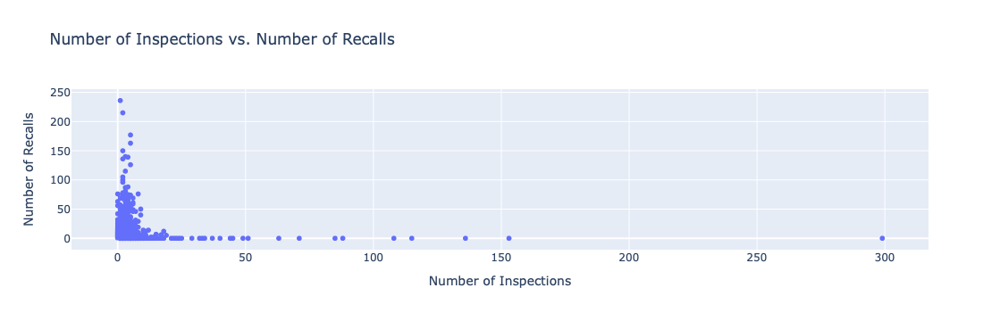

In [45]:
# Plotly scatter plot for number of inspections vs. number of recalls
fig = px.scatter(result, x='Number of Inspections', y='Number of Recalls', title='Number of Inspections vs. Number of Recalls',
                 labels={'Number of Inspections': 'Number of Inspections', 'Number of Recalls': 'Number of Recalls'},
                 hover_data=['FEI Number'])

fig.show()


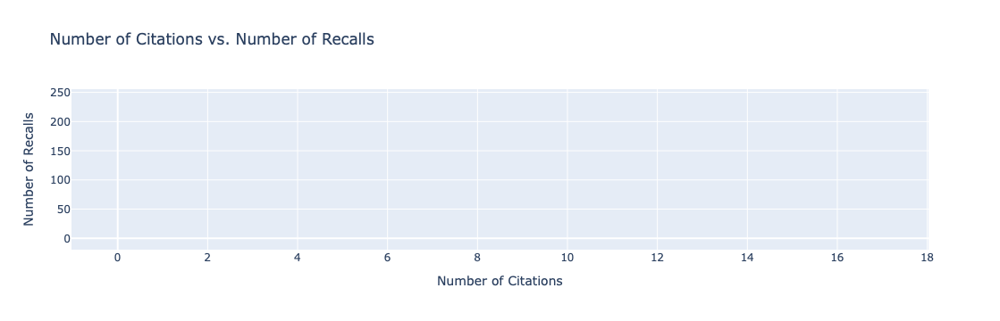

In [46]:
# Plotly scatter plot for number of inspections vs. number of recalls
fig = px.scatter(result, x='Number of Citations', y='Number of Recalls', title='Number of Citations vs. Number of Recalls',
                 labels={'Number of Citations': 'Number of Citations', 'Number of Recalls': 'Number of Recalls'},
                 hover_data=['FEI Number'])

fig.show()


If we autoscale Number of Inspections vs. Number of Recalls graph we can overall see the datapoints are heavily concentrated on the left side, which indicates that the companies with the least number of inspections have some of the highest number of recalls.

Another interesting data point is of FEI Number 3008657562 which has the highest number of inspections-299 but no recalls!
It seems like organizations that have high number of inspections, have the least number of recalls as per our dataset.

Looking at the Number of Citations vs. Number of Recalls graph, we can clearly see atleast 1 recalls for every citations, meaning every organization was issued a citation from FDA, has recalled their product atleast once.

#### But who are these oraganizations who are not being inspected but have high recalls? What is the impact of their recalls? Let us answer these questions

Considering the organizations that have less than 3 inspections but more than 100 recalls-

In [51]:
#Getting data about organizations which have less inspections but higher recalls
result2 = result[(result['Number of Inspections'] <= 2) & (result['Number of Recalls'] > 100)]


In [52]:
feinums = result2['FEI Number']

In [53]:
recall_2=recall[recall['FEI Number'].isin(feinums)]

In [54]:
recall_2.shape

(1723, 17)

In [55]:
recall_2.head()

,FEI Number,Recalling Firm Name,Product Type,Product Classification,Status,Distribution Pattern,Recalling Firm City,Recalling Firm State,Recalling Firm Country,Center Classification Date,Reason for Recall,Product Description,Event ID,Event Classification,Product ID,Center,Recall Details
202,2429304,Olympus Corporation of the Americas,Devices,Class II,Ongoing,Domestic: US Nationwide Distribution.,Center Valley,Pennsylvania,United States,2024-11-20,To better define the drying procedures describ...,Brand Name: EVIS EXERA III Gastrointestinal Vi...,95600,Class II,210743,CDRH,https://www.accessdata.fda.gov/scripts/ires/?P...
410,2429304,Olympus Corporation of the Americas,Devices,Class II,Ongoing,Worldwide distribution - US Nationwide and the...,Center Valley,Pennsylvania,United States,2024-11-12,Exposure of the UroPass product to Ultraviolet...,Brand Name: UroPass Ureteral Access Sheaths_x0...,95570,Class II,210637,CDRH,https://www.accessdata.fda.gov/scripts/ires/?P...
437,2429304,Olympus Corporation of the Americas,Devices,Class II,Ongoing,US Nationwide distribution including in the st...,Center Valley,Pennsylvania,United States,2024-11-08,Olympus is removing the statement of compatibi...,Brand Name: Olympus_x000D_\nProduct Name: Cyst...,95584,Class II,210677,CDRH,https://www.accessdata.fda.gov/scripts/ires/?P...
483,1070196,"OneBlood, Inc.",Biologics,Class II,Terminated,CAYMAN ISLANDS,St Petersburg,Florida,United States,2024-11-06,"Leukoreduced Apheresis Red Blood Cells, which ...","Apheresis Red Blood Cells, Leukocytes Reduced",95680,Class II,210932,CBER,https://www.accessdata.fda.gov/scripts/ires/?P...
598,2429304,Olympus Corporation of the Americas,Devices,Class II,Ongoing,US Nationwide.,Center Valley,Pennsylvania,United States,2024-10-30,There was an increase in complaints indicating...,"Olympus Electrosurgical Generator, Model Numbe...",95477,Class II,210352,CDRH,https://www.accessdata.fda.gov/scripts/ires/?P...


In [56]:
recall_2.columns

Index(['FEI Number', 'Recalling Firm Name', 'Product Type',
       'Product Classification', 'Status', 'Distribution Pattern',
       'Recalling Firm City', 'Recalling Firm State', 'Recalling Firm Country',
       'Center Classification Date', 'Reason for Recall',
       'Product Description', 'Event ID', 'Event Classification', 'Product ID',
       'Center', 'Recall Details'],
      dtype='object')

#### Most common word in reason for recall

In [58]:
reasonRecall=' '.join(recall_2['Reason for Recall'])

In [59]:
stopWords=set(stopwords.words('english'))
custom_stop_words = {'may', 'become', 'system','risk', 'result','channel','ceiling','due','could','potential','prolonged','monitor','cause','incorrect','patient'}
#addding my own custom stop words
stopWords.update(custom_stop_words)
translator=str.maketrans('', '', string.punctuation)#removing punctuation marks
text = reasonRecall.translate(translator) #Removing punctuation from the text using the translator created earlier.
words = text.split() #splitting the words in into a list of words, tokenizing the words
words = [word for word in words if word not in stopWords] #removing stop words
word=' '.join(words)

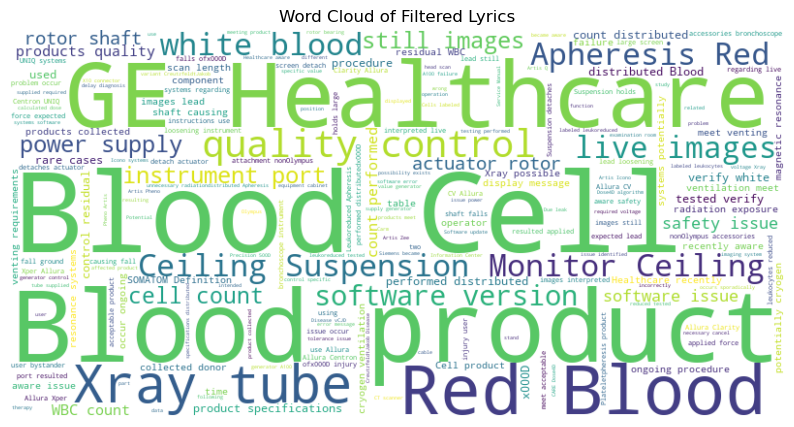

In [60]:
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(word)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Filtered Lyrics')
plt.show()

#### Lets dig deeper! What is the most common word that occurs in reason for recall every year? 

In [62]:
recall_2['Year'] = recall_2['Center Classification Date'].dt.year

#Getting frequency of recalls by year
yearly_recalls = recall_2.groupby('Year').size()

#Common words in 'Reason for Recall' by year
stop_words = set(stopwords.words('english'))
custom_stop_words = {'may', 'become', 'system','risk', 'result','channel','ceiling','due','could','potential','prolonged','monitor','cause','incorrect','patient'}
all_stop_words = stop_words.union(custom_stop_words)

recall_2['Reason for Recall'] = recall_2['Reason for Recall'].str.lower()
common_words = {}
for year in recall_2['Year'].unique():
    words = ' '.join(recall_2[recall_2['Year'] == year]['Reason for Recall'])
    word_list = words.split()
    word_list = [word for word in word_list if word not in all_stop_words]
    word_freq = Counter(word_list)
    most_common_word = word_freq.most_common(1)[0][0]
    common_words[year] = most_common_word


/var/folders/vk/2h2l_jqx5y30_k3w_rwjdw440000gn/T/ipykernel_10003/2327115855.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/vk/2h2l_jqx5y30_k3w_rwjdw440000gn/T/ipykernel_10003/2327115855.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



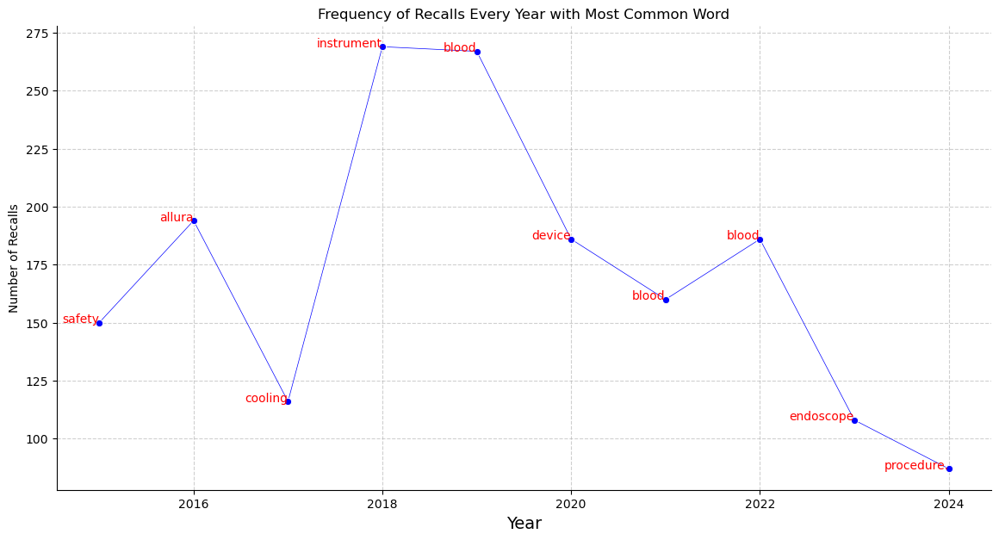

In [63]:
plt.figure(figsize=(14, 7))
sns.lineplot(data=yearly_recalls, marker='o', color='blue', linewidth=0.5)

for year, word in common_words.items():
    plt.text(year, yearly_recalls[year], word, horizontalalignment='right', color='red', fontsize=10)

plt.title('Frequency of Recalls Every Year with Most Common Word')
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Recalls', fontsize=10)
plt.grid(True, linestyle='--', alpha=0.6)
sns.despine()

plt.show()

In conclusion, certain organizations  have exceptionally high recalls while having low inspections. In these high recalls vs inspection organizations, most of the products over the years were focused on blood related products. 

Overall, my hypothesis was just the opposite of the outcome, the organizations that have higher inspections tend to have less recalls with most of the products being healthcare.

### Shobha's Hypothesis: Is there a trend in FDA inspection outcomes and recalls over different fiscal years and are they correlated ?

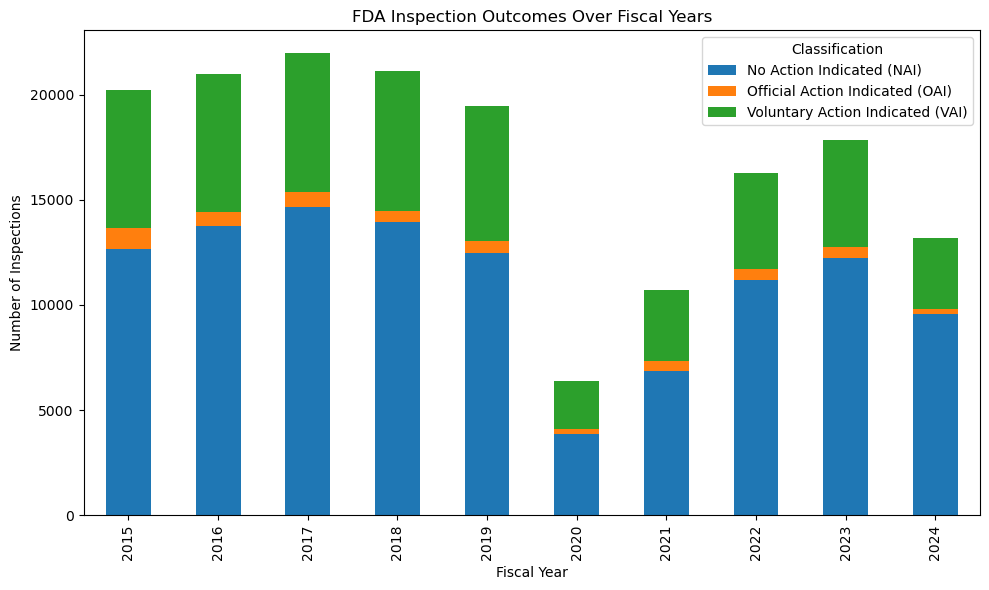

In [136]:
#extracting the fiscal year from the "Inspection End Date" column
insp["Fiscal Year"] = insp["Inspection End Date"].dt.year

#extracting the fiscal year from the "Center Classification Date" column
recall["Fiscal Year"] = recall["Center Classification Date"].dt.year

#selecting only the relevant columns for inspections data and recalls data
inspections = insp[["Fiscal Year", "Classification"]]
recalls = recall[["Fiscal Year", "Reason for Recall",'Event Classification']]

#grouping inspections data by "Fiscal Year" and "Classification" to count the occurrences of each classification
inspection_trends = inspections.groupby(["Fiscal Year", "Classification"]).size().unstack(fill_value=0)

#grouping recalls data by "Fiscal Year" and "Event Classification" to count the occurrences of each classification
recalls_trends = recalls.groupby(["Fiscal Year", "Event Classification"]).size().unstack(fill_value=0)

# Plot Inspection Trends
inspection_trends.plot(kind="bar", stacked=True, figsize=(10, 6))
plt.title("FDA Inspection Outcomes Over Fiscal Years")
plt.ylabel("Number of Inspections")
plt.xlabel("Fiscal Year")
plt.legend(title="Classification")
plt.tight_layout()
plt.show()

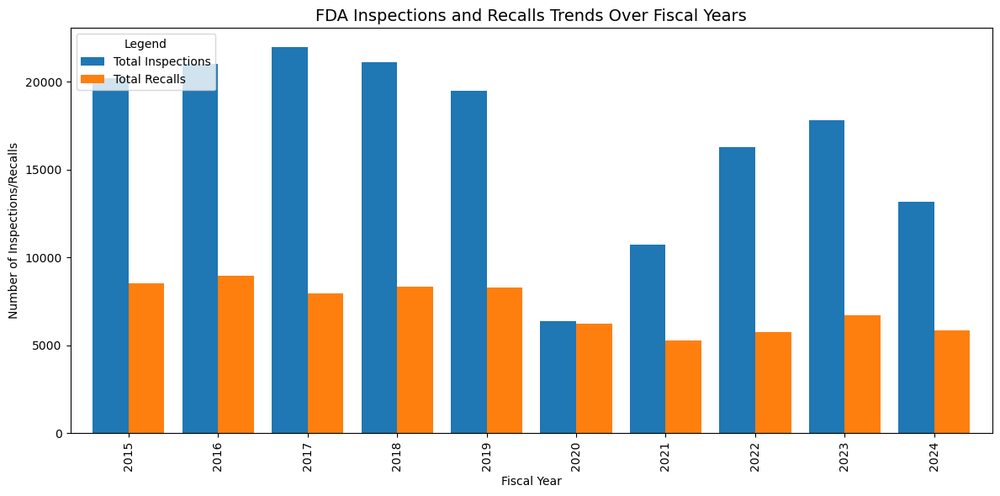

In [66]:
#Calculating total inspections and recalls for each fiscal year

inspection_totals = inspection_trends.sum(axis=1)
recall_totals = recalls_trends.sum(axis=1)
#Combine data for inspections and recalls
combined_data = pd.DataFrame({
    "Total Inspections": inspection_totals,
    "Total Recalls": recall_totals
})

#plotting bar chart
combined_data.plot(kind="bar", figsize=(12, 6), width=0.8, color=["#1f77b4", "#ff7f0e"])
#Add titles and labels
plt.title("FDA Inspections and Recalls Trends Over Fiscal Years", fontsize=14)
plt.ylabel("Number of Inspections/Recalls")
plt.xlabel("Fiscal Year")
plt.legend(["Total Inspections", "Total Recalls"], title="Legend", loc="upper left")

#Show the plot
plt.tight_layout()
plt.show()

The recall trend closely follows the inspection trend, with higher inspection activity often leading to more recalls. 

From 2015 to 2017, inspections increased slightly, and recalls also increased. In 2018, inspections peaked, and recalls rose sharply. In 2019, both inspections and recalls dropped slightly.

In 2020, there was a significant drop in inspections, likely due to COVID-19-related restrictions, which also led to a noticeable decrease in recalls, highlighting the impact of reduced inspection activity on recalls. From 2021 to 2023, inspections gradually recovered, and recalls began to rise again, although slightly lagging behind the recovery in inspections.This shows inspections are essential for finding issues that lead to recalls.

This suggests inspections play a key role in identifying issues that trigger recalls, with occasional time lags between the two.

The graph supports the hypothesis by showing that inspection and recall trends are correlated over fiscal years. 


### Ajay's Hypothesis: Food products manufactured by firms in states with higher GDP are subject to more frequent FDA inspections due to the larger scale of production and distribution.

In [69]:
#Creating random data for all the states and their GDP value (random)
gdp_data = {
    'State': [
        'Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California', 'Colorado',
        'Connecticut', 'Delaware', 'Florida', 'Georgia', 'Hawaii', 'Idaho',
        'Illinois', 'Indiana', 'Iowa', 'Kansas', 'Kentucky', 'Louisiana', 'Maine', 'Maryland',
        'Massachusetts', 'Michigan', 'Minnesota', 'Mississippi', 'Missouri', 'Montana',
        'Nebraska', 'Nevada', 'New Hampshire', 'New Jersey', 'New Mexico', 'New York',
        'North Carolina', 'North Dakota', 'Ohio', 'Oklahoma', 'Oregon', 'Pennsylvania',
        'Rhode Island', 'South Carolina', 'South Dakota', 'Tennessee', 'Texas', 'Utah',
        'Vermont', 'Virginia', 'Washington', 'West Virginia', 'Wisconsin', 'Wyoming',
        'Puerto Rico', 'District of Columbia', 'Virgin Islands', 'Guam', 'Northern Mariana Islands', 'American Samoa'
    ],
    'GDP': [
        2563, 1096, 3482, 1456, 35251, 4021, 2263, 701, 16916, 6122, 1828, 1811,
        9706, 4140, 3100, 3015, 3569, 3286, 1489, 4181, 6514, 6175, 8099, 1528,
        5491, 1301, 1893, 1297, 1130, 9916, 1171, 14458, 5499, 1782, 9950, 2058,
        4327, 11278, 772, 2324, 1583, 5477, 15594, 2571, 989, 682, 7798, 806,
        9386, 199, 3576, 427, 130, 74, 23, 14
    ]
}
#storing in dataframe
gdp_df = pd.DataFrame(gdp_data)


In [70]:
#Counting the number of inspections for each state by grouping
insp_state_count = insp.groupby('State').size().reset_index(name='Inspection Count')

#Now Counting the number of recalls for each state
recall_state_count = recall.groupby('Recalling Firm State').size().reset_index(name='Recall Count')

#Standardizing column names for merging (rename 'Recalling Firm State' to 'State')
recall_state_count.rename(columns={'Recalling Firm State': 'State'}, inplace=True)

# Merge inspection and recall data with GDP data (without merging the dataframes directly)
state_data = pd.merge(insp_state_count, gdp_df, on='State', how='left')
state_data = pd.merge(state_data, recall_state_count, on='State', how='left')



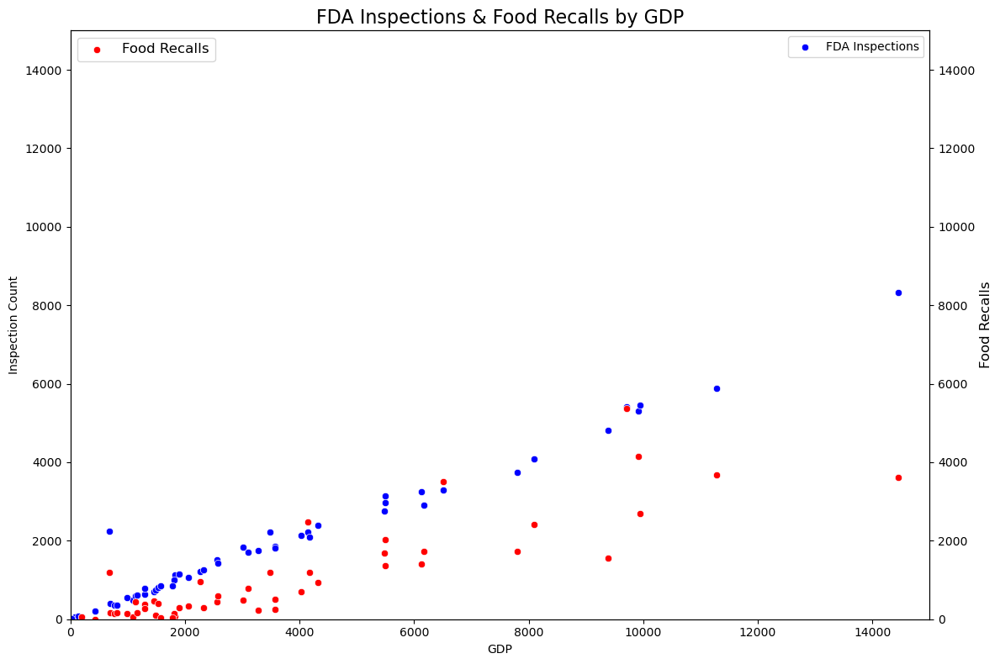

In [71]:
#Visualizing the relationship between GDP, Inspection Count, and Recall Count
plt.figure(figsize=(12, 8))

#Plotting GDP vs Inspection Count and Recall Count (use a secondary axis for recalls)
sns.scatterplot(x='GDP', y='Inspection Count', data=state_data, color='blue', label='FDA Inspections').set(ylim=(0, 15000))
#Adding a second y-axis for recalls
ax2 = plt.gca().twinx()
sns.scatterplot(x='GDP', y='Recall Count', data=state_data, color='red', label='Food Recalls', ax=ax2)

#appending the plot
plt.title('FDA Inspections & Food Recalls by GDP', fontsize=16)
plt.xlabel('GDP (in millions)', fontsize=12)
plt.ylabel('FDA Inspections', fontsize=12)
ax2.set_ylabel('Food Recalls', fontsize=12)

#Adding legends
plt.legend(loc='upper left', fontsize=12)
ax2.legend(loc='upper left', fontsize=12)

plt.xlim(0, 15000)         
plt.ylim(0, 15000)   #Primary y-axis
ax2.set_ylim(0, 15000)

#Main plot
plt.tight_layout()
plt.show()

The graph shows a positive correlation between the GDP of states and the frequency of FDA inspections, as well as food recalls. States with higher GDP exhibit a greater number of FDA inspections and food recalls, likely due to their higher production volumes and broader distribution networks. This supports the hypothesis that states with higher GDP are subject to more frequent FDA inspections and food recalls.

### Mitaali's hypothesis: Recalls classified as Class I are more likely to involve products distributed nationwide compared to Class II and Class III recalls.


In [74]:

# Preprocess data: Filter rows for Class I, Class II, and Class III recalls
class_i_recall = recall[recall['Event Classification'] == 'Class I']
class_ii_recall = recall[recall['Event Classification'] == 'Class II']
class_iii_recall = recall[recall['Event Classification'] == 'Class III']

# Define a function to check if a recall involves nationwide distribution
def is_nationwide(distribution_pattern):
    return 'nationwide' in str(distribution_pattern).lower() or 'usa' in str(distribution_pattern).lower() or 'united states'in str(distribution_pattern).lower() or 'the united states'in str(distribution_pattern).lower()

# Apply the function to each group
class_i_recall['Is Nationwide'] = class_i_recall['Distribution Pattern'].apply(is_nationwide)
class_ii_recall['Is Nationwide'] = class_ii_recall['Distribution Pattern'].apply(is_nationwide)
class_iii_recall['Is Nationwide'] = class_iii_recall['Distribution Pattern'].apply(is_nationwide)

# Calculate percentages of nationwide distribution for each class
class_i_nationwide_percentage = class_i_recall['Is Nationwide'].mean() * 100
class_ii_nationwide_percentage = class_ii_recall['Is Nationwide'].mean() * 100
class_iii_nationwide_percentage = class_iii_recall['Is Nationwide'].mean() * 100

# Output results
print("Percentage of Nationwide Distribution:")
print(f"Class I: {class_i_nationwide_percentage:.2f}%")
print(f"Class II: {class_ii_nationwide_percentage:.2f}%")
print(f"Class III: {class_iii_nationwide_percentage:.2f}%")


Percentage of Nationwide Distribution:
Class I: 34.30%
Class II: 56.08%
Class III: 33.13%


/var/folders/vk/2h2l_jqx5y30_k3w_rwjdw440000gn/T/ipykernel_10003/3435082744.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/vk/2h2l_jqx5y30_k3w_rwjdw440000gn/T/ipykernel_10003/3435082744.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/vk/2h2l_jqx5y30_k3w_rwjdw440000gn/T/ipykernel_10003/3435082744.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

In [75]:
# Check if there have been inspections for Class I recalls using FEI Number
class_i_recall_with_insp = class_i_recall.merge(insp, on='FEI Number', how='inner')

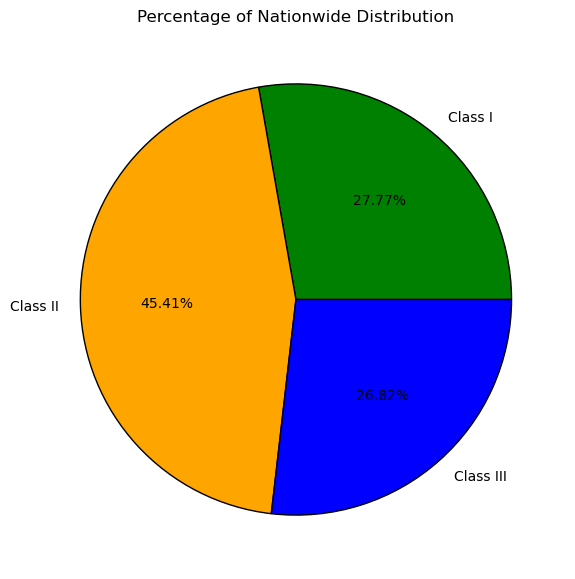

In [76]:
# Data for the pie chart
labels = ['Class I', 'Class II', 'Class III']
sizes = [class_i_nationwide_percentage, class_ii_nationwide_percentage, class_iii_nationwide_percentage]
colors = ['Green','Orange','Blue']  # You can choose different colors

# Plotting the pie chart
plt.figure(figsize=(7,7))
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.2f%%', wedgeprops={'edgecolor': 'black'}) 
plt.title('Percentage of Nationwide Distribution')
plt.show() 

The above output shows that the Class II recalls have the highest percentage of nationwide distribution, followed by Class I and Class III recalls. Therefore, my hypothesis is not supported by the data. This suggests that Class II recalls, despite being less severe, may involve products with broader market reach or more widespread issues.